In [6]:
import pandas as pd
import numpy as np
import seaborn as sns;
from sklearn import preprocessing
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow import keras
from numpy import array
from keras.models import Sequential
from keras.layers import LSTM
from keras.layers import Dense
from keras import optimizers
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error

Using TensorFlow backend.


In [7]:
# loading the data into the dataframe
df = pd.read_csv('data.csv') 
print(df) 

          No  year  month  day  hour  PM2.5  PM10   SO2   NO2   CO    O3  \
0          1  2013      3    1     0    4.0   4.0   4.0   7.0  300  77.0   
1          2  2013      3    1     1    8.0   8.0   4.0   7.0  300  77.0   
2          3  2013      3    1     2    7.0   7.0   5.0  10.0  300  73.0   
3          4  2013      3    1     3    6.0   6.0  11.0  11.0  300  72.0   
4          5  2013      3    1     4    3.0   3.0  12.0  12.0  300  72.0   
...      ...   ...    ...  ...   ...    ...   ...   ...   ...  ...   ...   
31891  35060  2017      2   28    19   12.0  29.0   5.0  35.0  400  95.0   
31892  35061  2017      2   28    20   13.0  37.0   7.0  45.0  500  81.0   
31893  35062  2017      2   28    21   16.0  37.0  10.0  66.0  700  58.0   
31894  35063  2017      2   28    22   21.0  44.0  12.0  87.0  700  35.0   
31895  35064  2017      2   28    23   19.0  31.0  10.0  79.0  600  42.0   

       TEMP    PRES  DEWP  RAIN   wd  WSPM  
0      -0.7  1023.0 -18.8   0.0  NNW   4.4

In [111]:
# viewing info about the columns
df.info();

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31896 entries, 0 to 31895
Data columns (total 17 columns):
No       31896 non-null int64
year     31896 non-null int64
month    31896 non-null int64
day      31896 non-null int64
hour     31896 non-null int64
PM2.5    31896 non-null float64
PM10     31896 non-null float64
SO2      31896 non-null float64
NO2      31896 non-null float64
CO       31896 non-null int64
O3       31896 non-null float64
TEMP     31876 non-null float64
PRES     31876 non-null float64
DEWP     31876 non-null float64
RAIN     31876 non-null float64
wd       31821 non-null object
WSPM     31882 non-null float64
dtypes: float64(10), int64(6), object(1)
memory usage: 4.1+ MB


In [112]:
#viewing few rows from the top
df.head()

,No,year,month,day,hour,PM2.5,PM10,SO2,NO2,CO,O3,TEMP,PRES,DEWP,RAIN,wd,WSPM
0,1,2013,3,1,0,4.0,4.0,4.0,7.0,300,77.0,-0.7,1023.0,-18.8,0.0,NNW,4.4
1,2,2013,3,1,1,8.0,8.0,4.0,7.0,300,77.0,-1.1,1023.2,-18.2,0.0,N,4.7
2,3,2013,3,1,2,7.0,7.0,5.0,10.0,300,73.0,-1.1,1023.5,-18.2,0.0,NNW,5.6
3,4,2013,3,1,3,6.0,6.0,11.0,11.0,300,72.0,-1.4,1024.5,-19.4,0.0,NW,3.1
4,5,2013,3,1,4,3.0,3.0,12.0,12.0,300,72.0,-2.0,1025.2,-19.5,0.0,N,2.0


In [113]:
#number of rows and columns in the dataset
print(df.shape)

(31896, 17)


In [114]:
#statistical information about columns
print(df.describe())

                 No          year         month           day          hour  \
count  31896.000000  31896.000000  31896.000000  31896.000000  31896.000000   
mean   17933.567595   2014.718930      6.400176     15.584587     11.623276   
std    10071.057418      1.164307      3.419374      8.793479      6.930351   
min        1.000000   2013.000000      1.000000      1.000000      0.000000   
25%     9436.750000   2014.000000      3.000000      8.000000      6.000000   
50%    18132.500000   2015.000000      6.000000     15.000000     12.000000   
75%    26648.250000   2016.000000      9.000000     23.000000     18.000000   
max    35064.000000   2017.000000     12.000000     31.000000     23.000000   

              PM2.5          PM10           SO2           NO2            CO  \
count  31896.000000  31896.000000  31896.000000  31896.000000  31896.000000   
mean      81.885265    109.126806     17.155964     59.017494   1257.362208   
std       80.444972     93.686186     22.743912    

In [115]:
#checking how many null values are in each column
df.isnull().sum()

No        0
year      0
month     0
day       0
hour      0
PM2.5     0
PM10      0
SO2       0
NO2       0
CO        0
O3        0
TEMP     20
PRES     20
DEWP     20
RAIN     20
wd       75
WSPM     14
dtype: int64

In [116]:
# dropping all the rows with NaN values
df.dropna()

,No,year,month,day,hour,PM2.5,PM10,SO2,NO2,CO,O3,TEMP,PRES,DEWP,RAIN,wd,WSPM
0,1,2013,3,1,0,4.0,4.0,4.0,7.0,300,77.0,-0.7,1023.0,-18.8,0.0,NNW,4.4
1,2,2013,3,1,1,8.0,8.0,4.0,7.0,300,77.0,-1.1,1023.2,-18.2,0.0,N,4.7
2,3,2013,3,1,2,7.0,7.0,5.0,10.0,300,73.0,-1.1,1023.5,-18.2,0.0,NNW,5.6
3,4,2013,3,1,3,6.0,6.0,11.0,11.0,300,72.0,-1.4,1024.5,-19.4,0.0,NW,3.1
4,5,2013,3,1,4,3.0,3.0,12.0,12.0,300,72.0,-2.0,1025.2,-19.5,0.0,N,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31891,35060,2017,2,28,19,12.0,29.0,5.0,35.0,400,95.0,12.5,1013.5,-16.2,0.0,NW,2.4
31892,35061,2017,2,28,20,13.0,37.0,7.0,45.0,500,81.0,11.6,1013.6,-15.1,0.0,WNW,0.9
31893,35062,2017,2,28,21,16.0,37.0,10.0,66.0,700,58.0,10.8,1014.2,-13.3,0.0,NW,1.1
31894,35063,2017,2,28,22,21.0,44.0,12.0,87.0,700,35.0,10.5,1014.4,-12.9,0.0,NNW,1.2


In [8]:
#defining training and testing data
x_train = df[:30525]
y_train = x_train['PM2.5']
x_test = df[30525:31898]
y_test = x_test['PM2.5']
print(y_test)

30525    477.0
30526    454.0
30527    418.0
30528    438.0
30529    453.0
         ...  
31891     12.0
31892     13.0
31893     16.0
31894     21.0
31895     19.0
Name: PM2.5, Length: 1371, dtype: float64


In [9]:
#Normalize training data
train_norm = x_train['PM2.5'] 
train_norm_arr = np.asarray(train_norm)
train_norm = np.reshape(train_norm_arr, (-1, 1))
scaler = MinMaxScaler(feature_range=(0, 1))
train_norm = scaler.fit_transform(train_norm)
for i in range(len(train_norm)):
    print(train_norm[i])

[0.00140845]
[0.00704225]
[0.0056338]
[0.00422535]
[0.]
[0.0028169]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.00422535]
[0.00704225]
[0.0084507]
[0.00985915]
[0.01126761]
[0.00704225]
[0.01126761]
[0.01267606]
[0.01690141]
[0.02957746]
[0.02676056]
[0.01549296]
[0.01408451]
[0.]
[0.]
[0.0084507]
[0.00140845]
[0.]
[0.]
[0.00985915]
[0.01126761]
[0.02112676]
[0.03239437]
[0.03098592]
[0.03239437]
[0.04788732]
[0.04788732]
[0.05774648]
[0.07183099]
[0.08169014]
[0.09014085]
[0.1]
[0.10985915]
[0.12676056]
[0.15352113]
[0.14929577]
[0.15070423]
[0.14366197]
[0.14507042]
[0.13802817]
[0.12394366]
[0.10704225]
[0.10422535]
[0.11267606]
[0.12816901]
[0.13098592]
[0.12394366]
[0.13380282]
[0.0971831]
[0.06338028]
[0.03521127]
[0.03239437]
[0.02957746]
[0.02253521]
[0.08028169]
[0.16056338]
[0.07183099]
[0.06056338]
[0.05492958]
[0.06478873]
[0.00985915]
[0.01408451]
[0.01549296]
[0.01408451]
[0.01690141]
[0.01830986]
[0.02112676]
[0.01408451]
[0.]
[0.]
[0.00985915]
[0.01549296]
[0.02394366]
[

[0.08169014]
[0.07183099]
[0.07042254]
[0.07183099]
[0.06619718]
[0.06619718]
[0.06056338]
[0.08309859]
[0.1028169]
[0.0971831]
[0.0971831]
[0.06760563]
[0.04788732]
[0.05352113]
[0.05352113]
[0.12676056]
[0.1056338]
[0.1056338]
[0.07323944]
[0.06760563]
[0.06760563]
[0.05633803]
[0.04507042]
[0.04225352]
[0.04366197]
[0.05211268]
[0.05070423]
[0.05633803]
[0.05633803]
[0.04788732]
[0.05211268]
[0.06760563]
[0.06760563]
[0.06901408]
[0.08028169]
[0.1]
[0.1]
[0.08169014]
[0.07042254]
[0.06619718]
[0.06197183]
[0.06197183]
[0.05492958]
[0.01267606]
[0.00704225]
[0.0084507]
[0.0084507]
[0.00985915]
[0.0028169]
[0.01267606]
[0.01267606]
[0.01267606]
[0.00985915]
[0.00985915]
[0.01126761]
[0.0084507]
[0.00985915]
[0.00985915]
[0.00985915]
[0.0084507]
[0.0084507]
[0.01408451]
[0.01267606]
[0.02676056]
[0.04225352]
[0.05633803]
[0.06619718]
[0.09014085]
[0.09014085]
[0.07746479]
[0.07464789]
[0.07464789]
[0.06619718]
[0.06619718]
[0.05492958]
[0.05211268]
[0.03943662]
[0.04084507]
[0.05492958

[0.05352113]
[0.05352113]
[0.07183099]
[0.08169014]
[0.08028169]
[0.08591549]
[0.0943662]
[0.16338028]
[0.2084507]
[0.28028169]
[0.29295775]
[0.31971831]
[0.31690141]
[0.32253521]
[0.34788732]
[0.30704225]
[0.31830986]
[0.32676056]
[0.25492958]
[0.20985915]
[0.16619718]
[0.16619718]
[0.16619718]
[0.16760563]
[0.16197183]
[0.18309859]
[0.18309859]
[0.17323944]
[0.17746479]
[0.18732394]
[0.22957746]
[0.24084507]
[0.23098592]
[0.22394366]
[0.24084507]
[0.24929577]
[0.24084507]
[0.18732394]
[0.14225352]
[0.0943662]
[0.07042254]
[0.06619718]
[0.07464789]
[0.08309859]
[0.14366197]
[0.10140845]
[0.12112676]
[0.13661972]
[0.15211268]
[0.15211268]
[0.2028169]
[0.18591549]
[0.19014085]
[0.18591549]
[0.20704225]
[0.28169014]
[0.24225352]
[0.25211268]
[0.23521127]
[0.20422535]
[0.20985915]
[0.18591549]
[0.17605634]
[0.16056338]
[0.16619718]
[0.13380282]
[0.1084507]
[0.1084507]
[0.09859155]
[0.10985915]
[0.09859155]
[0.10985915]
[0.10985915]
[0.10422535]
[0.1028169]
[0.1]
[0.1]
[0.0915493]
[0.08169

[0.18873239]
[0.2028169]
[0.2056338]
[0.20422535]
[0.13661972]
[0.11126761]
[0.08450704]
[0.08169014]
[0.07042254]
[0.06338028]
[0.06056338]
[0.06056338]
[0.06056338]
[0.07464789]
[0.06901408]
[0.07323944]
[0.06619718]
[0.05633803]
[0.04084507]
[0.03802817]
[0.03661972]
[0.03943662]
[0.04084507]
[0.04647887]
[0.05352113]
[0.05915493]
[0.05915493]
[0.06478873]
[0.07323944]
[0.0943662]
[0.08028169]
[0.06056338]
[0.06619718]
[0.0943662]
[0.11267606]
[0.12253521]
[0.12112676]
[0.11971831]
[0.06338028]
[0.04507042]
[0.06901408]
[0.04788732]
[0.05633803]
[0.07746479]
[0.08169014]
[0.09577465]
[0.12535211]
[0.13239437]
[0.11690141]
[0.0971831]
[0.07464789]
[0.11690141]
[0.16056338]
[0.16478873]
[0.19577465]
[0.21690141]
[0.23802817]
[0.24929577]
[0.23098592]
[0.22957746]
[0.26197183]
[0.26197183]
[0.12112676]
[0.09577465]
[0.07605634]
[0.07323944]
[0.10985915]
[0.10985915]
[0.18028169]
[0.14366197]
[0.12535211]
[0.09014085]
[0.01408451]
[0.01830986]
[0.01549296]
[0.02112676]
[0.03661972]
[0.0

[0.16901408]
[0.17464789]
[0.18450704]
[0.1971831]
[0.19014085]
[0.18873239]
[0.18732394]
[0.14929577]
[0.1]
[0.01408451]
[0.00704225]
[0.0056338]
[0.00704225]
[0.01408451]
[0.01267606]
[0.0084507]
[0.0056338]
[0.]
[0.0056338]
[0.0084507]
[0.00422535]
[0.01549296]
[0.01549296]
[0.01549296]
[0.02253521]
[0.02112676]
[0.01971831]
[0.02816901]
[0.02394366]
[0.01408451]
[0.01408451]
[0.0056338]
[0.00422535]
[0.00985915]
[0.00422535]
[0.00704225]
[0.00985915]
[0.0084507]
[0.]
[0.]
[0.00140845]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.00985915]
[0.02394366]
[0.02816901]
[0.03239437]
[0.02676056]
[0.01690141]
[0.01267606]
[0.]
[0.]
[0.0084507]
[0.00985915]
[0.0056338]
[0.01267606]
[0.01267606]
[0.01830986]
[0.01549296]
[0.01830986]
[0.0084507]
[0.00422535]
[0.01267606]
[0.00985915]
[0.01126761]
[0.00985915]
[0.01126761]
[0.01267606]
[0.01267606]
[0.01830986]
[0.01971831]
[0.02957746]
[0.05211268]
[0.04507042]
[0.03521127]
[0.03943662]
[0.03943662]
[0.02535211]
[0.02394366]
[0.01830986]
[0.02253521]
[0.022

[0.0056338]
[0.0084507]
[0.00140845]
[0.00985915]
[0.01408451]
[0.0084507]
[0.00985915]
[0.00985915]
[0.0084507]
[0.0056338]
[0.00704225]
[0.0028169]
[0.00985915]
[0.0084507]
[0.0084507]
[0.0056338]
[0.0028169]
[0.0084507]
[0.01126761]
[0.00985915]
[0.00704225]
[0.00985915]
[0.01408451]
[0.01690141]
[0.01126761]
[0.00985915]
[0.01549296]
[0.01267606]
[0.01126761]
[0.00704225]
[0.0056338]
[0.0084507]
[0.00704225]
[0.0056338]
[0.00704225]
[0.00140845]
[0.00422535]
[0.00422535]
[0.01267606]
[0.01971831]
[0.01267606]
[0.0056338]
[0.0056338]
[0.0056338]
[0.0028169]
[0.01690141]
[0.0084507]
[0.01690141]
[0.01549296]
[0.01830986]
[0.01408451]
[0.01267606]
[0.01267606]
[0.01971831]
[0.02253521]
[0.02535211]
[0.02957746]
[0.04366197]
[0.07887324]
[0.05915493]
[0.03943662]
[0.02816901]
[0.01971831]
[0.02394366]
[0.01971831]
[0.02816901]
[0.22676056]
[0.22957746]
[0.2084507]
[0.07605634]
[0.08732394]
[0.08591549]
[0.07464789]
[0.07183099]
[0.06760563]
[0.17042254]
[0.16760563]
[0.12112676]
[0.090

[0.09577465]
[0.15492958]
[0.13521127]
[0.14647887]
[0.20704225]
[0.21126761]
[0.19577465]
[0.2]
[0.17323944]
[0.16338028]
[0.11549296]
[0.07183099]
[0.04084507]
[0.05633803]
[0.05633803]
[0.0971831]
[0.12676056]
[0.17887324]
[0.16901408]
[0.12676056]
[0.08732394]
[0.06619718]
[0.07746479]
[0.14507042]
[0.14507042]
[0.14366197]
[0.11830986]
[0.10985915]
[0.10985915]
[0.14507042]
[0.14084507]
[0.1915493]
[0.22253521]
[0.24366197]
[0.10704225]
[0.0971831]
[0.0943662]
[0.06619718]
[0.06056338]
[0.05352113]
[0.05774648]
[0.06478873]
[0.06478873]
[0.05774648]
[0.05774648]
[0.06197183]
[0.06619718]
[0.08028169]
[0.17464789]
[0.49859155]
[0.60985915]
[0.64788732]
[0.66056338]
[0.6915493]
[0.69859155]
[0.71549296]
[0.74225352]
[0.75352113]
[0.74929577]
[0.72957746]
[0.66478873]
[0.55633803]
[0.53521127]
[0.54366197]
[0.55352113]
[0.58450704]
[0.59014085]
[0.40140845]
[0.22816901]
[0.16901408]
[0.16901408]
[0.18732394]
[0.31971831]
[0.39014085]
[0.48873239]
[0.4971831]
[0.38028169]
[0.35211268]

[0.09014085]
[0.04084507]
[0.00985915]
[0.00422535]
[0.]
[0.]
[0.]
[0.]
[0.02394366]
[0.04507042]
[0.04507042]
[0.06338028]
[0.08732394]
[0.11549296]
[0.13802817]
[0.15070423]
[0.16197183]
[0.18732394]
[0.17464789]
[0.15633803]
[0.17464789]
[0.16197183]
[0.15352113]
[0.14788732]
[0.15915493]
[0.18873239]
[0.19859155]
[0.21126761]
[0.21830986]
[0.21408451]
[0.18169014]
[0.17183099]
[0.17464789]
[0.17605634]
[0.19577465]
[0.20140845]
[0.22112676]
[0.25211268]
[0.3056338]
[0.35070423]
[0.35774648]
[0.27746479]
[0.21690141]
[0.1971831]
[0.22676056]
[0.23943662]
[0.26197183]
[0.28591549]
[0.2943662]
[0.30985915]
[0.31408451]
[0.33802817]
[0.36619718]
[0.37464789]
[0.3915493]
[0.37746479]
[0.33239437]
[0.31690141]
[0.31830986]
[0.32957746]
[0.32394366]
[0.32535211]
[0.34366197]
[0.36619718]
[0.38309859]
[0.37042254]
[0.36338028]
[0.27323944]
[0.05352113]
[0.0056338]
[0.00422535]
[0.]
[0.00140845]
[0.01971831]
[0.]
[0.]
[0.0084507]
[0.0056338]
[0.0056338]
[0.0084507]
[0.01267606]
[0.0028169]


[0.06901408]
[0.0943662]
[0.0943662]
[0.12112676]
[0.12816901]
[0.15352113]
[0.13098592]
[0.15915493]
[0.19577465]
[0.18873239]
[0.17746479]
[0.16760563]
[0.15492958]
[0.15915493]
[0.16197183]
[0.17042254]
[0.16760563]
[0.16760563]
[0.18309859]
[0.17464789]
[0.20704225]
[0.14507042]
[0.15070423]
[0.12394366]
[0.11408451]
[0.09295775]
[0.0971831]
[0.10985915]
[0.11126761]
[0.1056338]
[0.10985915]
[0.11830986]
[0.08732394]
[0.0943662]
[0.12816901]
[0.11971831]
[0.10704225]
[0.11549296]
[0.10422535]
[0.1]
[0.07605634]
[0.06197183]
[0.06338028]
[0.05633803]
[0.08309859]
[0.11971831]
[0.13098592]
[0.1028169]
[0.08450704]
[0.07042254]
[0.08169014]
[0.08309859]
[0.1]
[0.12816901]
[0.11267606]
[0.13380282]
[0.11830986]
[0.14084507]
[0.13380282]
[0.13239437]
[0.14366197]
[0.15352113]
[0.14788732]
[0.13521127]
[0.14647887]
[0.14788732]
[0.17464789]
[0.16619718]
[0.14084507]
[0.15352113]
[0.12957746]
[0.12676056]
[0.12816901]
[0.15774648]
[0.18309859]
[0.17605634]
[0.17605634]
[0.16760563]
[0.157

[0.07887324]
[0.07183099]
[0.07746479]
[0.09014085]
[0.1056338]
[0.11690141]
[0.12816901]
[0.14366197]
[0.14647887]
[0.14366197]
[0.14225352]
[0.14225352]
[0.09295775]
[0.08732394]
[0.1056338]
[0.12253521]
[0.11549296]
[0.11126761]
[0.0943662]
[0.0971831]
[0.1]
[0.11830986]
[0.12957746]
[0.12253521]
[0.11126761]
[0.10704225]
[0.11690141]
[0.12676056]
[0.13521127]
[0.13239437]
[0.13943662]
[0.13802817]
[0.15492958]
[0.16478873]
[0.17464789]
[0.17183099]
[0.23802817]
[0.26760563]
[0.27464789]
[0.21267606]
[0.09859155]
[0.02676056]
[0.02535211]
[0.01971831]
[0.01830986]
[0.01830986]
[0.01408451]
[0.01126761]
[0.01126761]
[0.01830986]
[0.02676056]
[0.03098592]
[0.04084507]
[0.02957746]
[0.02535211]
[0.02957746]
[0.01549296]
[0.01126761]
[0.02394366]
[0.05352113]
[0.05070423]
[0.03661972]
[0.02816901]
[0.03802817]
[0.03943662]
[0.03380282]
[0.03802817]
[0.05211268]
[0.05070423]
[0.05774648]
[0.03098592]
[0.02112676]
[0.02394366]
[0.04084507]
[0.05352113]
[0.04929577]
[0.04788732]
[0.0338028

[0.31267606]
[0.22676056]
[0.21126761]
[0.21267606]
[0.24788732]
[0.25633803]
[0.37464789]
[0.35633803]
[0.36056338]
[0.33943662]
[0.31267606]
[0.30704225]
[0.29577465]
[0.29859155]
[0.27746479]
[0.24084507]
[0.26901408]
[0.27042254]
[0.25492958]
[0.24788732]
[0.24507042]
[0.23380282]
[0.21408451]
[0.23380282]
[0.30704225]
[0.31830986]
[0.28450704]
[0.25492958]
[0.24507042]
[0.20704225]
[0.21408451]
[0.21971831]
[0.22112676]
[0.21408451]
[0.21971831]
[0.20422535]
[0.18591549]
[0.18450704]
[0.2084507]
[0.2056338]
[0.16338028]
[0.16056338]
[0.18450704]
[0.2056338]
[0.13521127]
[0.11971831]
[0.1028169]
[0.10140845]
[0.10985915]
[0.1084507]
[0.1028169]
[0.11267606]
[0.14788732]
[0.17746479]
[0.23943662]
[0.26338028]
[0.28732394]
[0.30704225]
[0.39014085]
[0.33661972]
[0.28028169]
[0.28169014]
[0.2971831]
[0.32394366]
[0.32112676]
[0.31408451]
[0.31690141]
[0.31830986]
[0.30704225]
[0.27887324]
[0.26478873]
[0.23943662]
[0.24225352]
[0.24084507]
[0.24929577]
[0.26197183]
[0.29295775]
[0.297

[0.06760563]
[0.07464789]
[0.0971831]
[0.1056338]
[0.1028169]
[0.0915493]
[0.08873239]
[0.02535211]
[0.02394366]
[0.02112676]
[0.0084507]
[0.01408451]
[0.01126761]
[0.00985915]
[0.00704225]
[0.00985915]
[0.00704225]
[0.0084507]
[0.01549296]
[0.]
[0.00985915]
[0.01408451]
[0.02394366]
[0.02676056]
[0.03239437]
[0.02957746]
[0.03098592]
[0.03943662]
[0.04507042]
[0.04647887]
[0.03943662]
[0.03943662]
[0.03239437]
[0.01549296]
[0.01408451]
[0.01408451]
[0.01971831]
[0.02253521]
[0.02394366]
[0.02112676]
[0.02676056]
[0.03521127]
[0.04647887]
[0.04929577]
[0.03943662]
[0.04507042]
[0.04788732]
[0.03943662]
[0.04788732]
[0.04225352]
[0.02676056]
[0.01549296]
[0.02957746]
[0.02816901]
[0.03380282]
[0.02957746]
[0.03380282]
[0.04507042]
[0.04647887]
[0.04225352]
[0.04929577]
[0.06478873]
[0.06197183]
[0.05070423]
[0.03661972]
[0.02816901]
[0.02676056]
[0.02253521]
[0.03380282]
[0.02253521]
[0.03352113]
[0.03943662]
[0.03661972]
[0.02535211]
[0.02535211]
[0.02535211]
[0.02676056]
[0.02535211]


[0.17605634]
[0.18873239]
[0.17746479]
[0.15352113]
[0.14084507]
[0.13521127]
[0.12816901]
[0.15211268]
[0.14929577]
[0.13239437]
[0.12253521]
[0.12253521]
[0.12676056]
[0.11267606]
[0.1]
[0.09014085]
[0.06760563]
[0.06056338]
[0.06197183]
[0.04929577]
[0.05070423]
[0.04788732]
[0.05492958]
[0.06197183]
[0.04366197]
[0.03943662]
[0.03239437]
[0.03661972]
[0.04084507]
[0.04507042]
[0.04788732]
[0.06338028]
[0.06478873]
[0.08309859]
[0.05915493]
[0.03802817]
[0.05211268]
[0.04929577]
[0.05211268]
[0.03521127]
[0.01126761]
[0.01126761]
[0.01267606]
[0.01408451]
[0.01549296]
[0.02535211]
[0.02676056]
[0.01408451]
[0.01690141]
[0.01971831]
[0.01690141]
[0.01549296]
[0.02535211]
[0.03661972]
[0.05352113]
[0.07605634]
[0.0915493]
[0.10140845]
[0.11830986]
[0.14788732]
[0.14366197]
[0.13661972]
[0.11830986]
[0.1056338]
[0.1]
[0.09014085]
[0.1]
[0.11830986]
[0.15492958]
[0.17746479]
[0.17464789]
[0.17746479]
[0.2028169]
[0.23380282]
[0.23098592]
[0.21830986]
[0.20704225]
[0.1943662]
[0.17605634

[0.12535211]
[0.08028169]
[0.04929577]
[0.06056338]
[0.08309859]
[0.09577465]
[0.09295775]
[0.06901408]
[0.04929577]
[0.06056338]
[0.05352113]
[0.06197183]
[0.07605634]
[0.07464789]
[0.08732394]
[0.10985915]
[0.10704225]
[0.10704225]
[0.13380282]
[0.16760563]
[0.18169014]
[0.18873239]
[0.2028169]
[0.25352113]
[0.2084507]
[0.2]
[0.17887324]
[0.01549296]
[0.00985915]
[0.0084507]
[0.00704225]
[0.0084507]
[0.01549296]
[0.01408451]
[0.01971831]
[0.01971831]
[0.02112676]
[0.01549296]
[0.01267606]
[0.00704225]
[0.0056338]
[0.00422535]
[0.00704225]
[0.0084507]
[0.0056338]
[0.0028169]
[0.0028169]
[0.0028169]
[0.0028169]
[0.00140845]
[0.0028169]
[0.]
[0.00704225]
[0.]
[0.00422535]
[0.00422535]
[0.0028169]
[0.]
[0.]
[0.0084507]
[0.00985915]
[0.00140845]
[0.00140845]
[0.]
[0.0028169]
[0.0028169]
[0.0028169]
[0.00422535]
[0.01267606]
[0.00704225]
[0.00140845]
[0.0028169]
[0.0084507]
[0.0056338]
[0.00704225]
[0.0084507]
[0.01267606]
[0.01126761]
[0.02535211]
[0.04225352]
[0.05352113]
[0.03380282]
[0

[0.00704225]
[0.01408451]
[0.01126761]
[0.01408451]
[0.00985915]
[0.01267606]
[0.01267606]
[0.00422535]
[0.01126761]
[0.01267606]
[0.01690141]
[0.01126761]
[0.03098592]
[0.05774648]
[0.06760563]
[0.06760563]
[0.05352113]
[0.06197183]
[0.08732394]
[0.11971831]
[0.11126761]
[0.12676056]
[0.12676056]
[0.13380282]
[0.14929577]
[0.15211268]
[0.13802817]
[0.0971831]
[0.06338028]
[0.03098592]
[0.02112676]
[0.01408451]
[0.01549296]
[0.01408451]
[0.02816901]
[0.04366197]
[0.02957746]
[0.02394366]
[0.01971831]
[0.02676056]
[0.04929577]
[0.10985915]
[0.14225352]
[0.12253521]
[0.11830986]
[0.13802817]
[0.16197183]
[0.18873239]
[0.1943662]
[0.18732394]
[0.18169014]
[0.20422535]
[0.24647887]
[0.24507042]
[0.24929577]
[0.23661972]
[0.22394366]
[0.20985915]
[0.2028169]
[0.1915493]
[0.2]
[0.23239437]
[0.23098592]
[0.22253521]
[0.21830986]
[0.21830986]
[0.21267606]
[0.23239437]
[0.25633803]
[0.24788732]
[0.24366197]
[0.25211268]
[0.33098592]
[0.42112676]
[0.44507042]
[0.38450704]
[0.24929577]
[0.2605633

[0.02535211]
[0.02676056]
[0.03239437]
[0.03943662]
[0.04507042]
[0.03661972]
[0.02957746]
[0.04929577]
[0.06197183]
[0.08450704]
[0.09295775]
[0.12112676]
[0.11549296]
[0.11690141]
[0.11690141]
[0.14366197]
[0.13239437]
[0.11549296]
[0.11549296]
[0.11408451]
[0.12535211]
[0.11549296]
[0.12112676]
[0.12816901]
[0.15211268]
[0.15492958]
[0.15774648]
[0.16478873]
[0.15633803]
[0.17323944]
[0.21408451]
[0.24647887]
[0.26619718]
[0.25774648]
[0.2943662]
[0.32253521]
[0.32957746]
[0.30985915]
[0.3]
[0.23239437]
[0.23661972]
[0.24647887]
[0.24929577]
[0.25774648]
[0.26056338]
[0.27183099]
[0.3]
[0.30985915]
[0.32394366]
[0.33380282]
[0.33098592]
[0.33943662]
[0.35633803]
[0.37887324]
[0.37605634]
[0.38309859]
[0.40422535]
[0.44929577]
[0.48732394]
[0.49014085]
[0.44084507]
[0.41971831]
[0.40422535]
[0.38450704]
[0.36338028]
[0.35492958]
[0.37323944]
[0.37464789]
[0.38873239]
[0.37464789]
[0.38450704]
[0.37042254]
[0.37464789]
[0.42112676]
[0.40704225]
[0.38591549]
[0.36901408]
[0.36478873]
[

[0.08450704]
[0.08873239]
[0.08732394]
[0.0971831]
[0.1056338]
[0.0943662]
[0.08873239]
[0.08873239]
[0.10140845]
[0.1084507]
[0.11549296]
[0.14225352]
[0.15633803]
[0.17042254]
[0.2056338]
[0.19014085]
[0.18591549]
[0.16760563]
[0.17183099]
[0.15633803]
[0.15774648]
[0.15352113]
[0.15915493]
[0.16760563]
[0.17746479]
[0.17746479]
[0.19014085]
[0.21830986]
[0.22535211]
[0.21690141]
[0.15070423]
[0.12112676]
[0.11971831]
[0.12112676]
[0.12253521]
[0.16338028]
[0.18450704]
[0.17464789]
[0.13380282]
[0.12957746]
[0.13098592]
[0.13661972]
[0.15211268]
[0.15774648]
[0.16478873]
[0.17605634]
[0.19014085]
[0.21267606]
[0.20140845]
[0.13943662]
[0.11549296]
[0.11126761]
[0.0971831]
[0.08309859]
[0.1]
[0.11549296]
[0.12112676]
[0.10985915]
[0.0971831]
[0.1]
[0.08169014]
[0.07464789]
[0.07605634]
[0.07746479]
[0.08309859]
[0.08873239]
[0.09295775]
[0.1]
[0.13521127]
[0.15633803]
[0.15492958]
[0.16197183]
[0.18169014]
[0.1971831]
[0.20985915]
[0.2056338]
[0.19577465]
[0.15352113]
[0.14366197]
[0.

[0.00704225]
[0.00985915]
[0.01126761]
[0.0056338]
[0.01126761]
[0.01267606]
[0.00985915]
[0.01549296]
[0.01549296]
[0.01549296]
[0.02676056]
[0.04929577]
[0.03943662]
[0.05352113]
[0.07183099]
[0.07605634]
[0.06760563]
[0.06197183]
[0.06338028]
[0.05915493]
[0.06197183]
[0.06760563]
[0.07746479]
[0.09577465]
[0.1028169]
[0.09577465]
[0.18873239]
[0.13098592]
[0.1]
[0.0971831]
[0.08450704]
[0.07183099]
[0.07183099]
[0.03661972]
[0.02112676]
[0.01830986]
[0.01830986]
[0.01267606]
[0.03943662]
[0.01971831]
[0.01549296]
[0.00985915]
[0.0084507]
[0.00704225]
[0.02676056]
[0.01690141]
[0.02112676]
[0.01830986]
[0.01549296]
[0.01408451]
[0.00985915]
[0.01267606]
[0.00985915]
[0.00704225]
[0.01830986]
[0.01830986]
[0.01971831]
[0.02394366]
[0.04366197]
[0.04647887]
[0.03661972]
[0.03521127]
[0.03802817]
[0.04366197]
[0.04507042]
[0.04788732]
[0.04929577]
[0.05352113]
[0.04647887]
[0.03661972]
[0.03943662]
[0.04225352]
[0.05211268]
[0.05915493]
[0.06619718]
[0.06197183]
[0.06197183]
[0.0535211

[0.08732394]
[0.09014085]
[0.06197183]
[0.06056338]
[0.06056338]
[0.05492958]
[0.07746479]
[0.09014085]
[0.08028169]
[0.03802817]
[0.04788732]
[0.04366197]
[0.04507042]
[0.04366197]
[0.04084507]
[0.03943662]
[0.03239437]
[0.05070423]
[0.03802817]
[0.04788732]
[0.05070423]
[0.05915493]
[0.06760563]
[0.07042254]
[0.08309859]
[0.08873239]
[0.08028169]
[0.0915493]
[0.0943662]
[0.02957746]
[0.00985915]
[0.01549296]
[0.00985915]
[0.0084507]
[0.02676056]
[0.0084507]
[0.0056338]
[0.00704225]
[0.00422535]
[0.00422535]
[0.00985915]
[0.00422535]
[0.0056338]
[0.00422535]
[0.00985915]
[0.01126761]
[0.01267606]
[0.00985915]
[0.0084507]
[0.0056338]
[0.00704225]
[0.00985915]
[0.0056338]
[0.01126761]
[0.0056338]
[0.00704225]
[0.0084507]
[0.00985915]
[0.01267606]
[0.01267606]
[0.02112676]
[0.02253521]
[0.03661972]
[0.05211268]
[0.02535211]
[0.02816901]
[0.02957746]
[0.02394366]
[0.02253521]
[0.03521127]
[0.05633803]
[0.05211268]
[0.04929577]
[0.04225352]
[0.04225352]
[0.05915493]
[0.02112676]
[0.0169014

[0.03098592]
[0.03521127]
[0.02816901]
[0.03380282]
[0.04788732]
[0.06056338]
[0.07605634]
[0.06901408]
[0.07042254]
[0.07323944]
[0.08028169]
[0.09859155]
[0.11126761]
[0.11971831]
[0.11126761]
[0.10140845]
[0.10985915]
[0.11971831]
[0.08732394]
[0.06478873]
[0.06056338]
[0.05352113]
[0.04929577]
[0.04647887]
[0.04507042]
[0.04647887]
[0.04929577]
[0.05211268]
[0.06056338]
[0.06760563]
[0.06478873]
[0.07605634]
[0.06338028]
[0.06901408]
[0.07746479]
[0.07746479]
[0.1]
[0.10704225]
[0.10985915]
[0.11267606]
[0.11690141]
[0.10704225]
[0.10140845]
[0.05492958]
[0.05211268]
[0.06197183]
[0.07887324]
[0.06760563]
[0.05774648]
[0.04507042]
[0.02535211]
[0.02957746]
[0.03521127]
[0.03098592]
[0.01690141]
[0.02394366]
[0.02535211]
[0.02676056]
[0.03098592]
[0.05211268]
[0.06338028]
[0.1084507]
[0.15070423]
[0.19859155]
[0.18309859]
[0.2028169]
[0.18028169]
[0.16901408]
[0.16619718]
[0.15070423]
[0.14225352]
[0.13380282]
[0.14366197]
[0.16760563]
[0.13380282]
[0.12253521]
[0.11408451]
[0.11549

[0.05352113]
[0.04225352]
[0.03380282]
[0.01690141]
[0.01549296]
[0.00704225]
[0.0084507]
[0.00422535]
[0.01126761]
[0.01830986]
[0.01690141]
[0.02394366]
[0.03380282]
[0.05492958]
[0.05774648]
[0.03943662]
[0.04366197]
[0.04647887]
[0.05352113]
[0.06338028]
[0.07887324]
[0.09014085]
[0.08873239]
[0.08732394]
[0.1]
[0.10422535]
[0.11549296]
[0.1028169]
[0.10985915]
[0.1056338]
[0.10985915]
[0.11267606]
[0.10985915]
[0.11549296]
[0.11267606]
[0.1]
[0.08309859]
[0.04366197]
[0.03380282]
[0.02816901]
[0.01690141]
[0.01408451]
[0.01690141]
[0.03521127]
[0.05774648]
[0.07464789]
[0.06760563]
[0.05352113]
[0.04225352]
[0.03239437]
[0.03521127]
[0.04225352]
[0.03802817]
[0.03521127]
[0.04647887]
[0.06338028]
[0.10140845]
[0.12394366]
[0.1056338]
[0.07042254]
[0.07183099]
[0.06619718]
[0.06901408]
[0.06901408]
[0.06760563]
[0.06197183]
[0.09014085]
[0.10422535]
[0.10422535]
[0.11126761]
[0.1084507]
[0.1084507]
[0.11549296]
[0.10985915]
[0.10140845]
[0.07183099]
[0.07605634]
[0.03943662]
[0.030

[0.12112676]
[0.13521127]
[0.12957746]
[0.12394366]
[0.11126761]
[0.10422535]
[0.10985915]
[0.12676056]
[0.18591549]
[0.22394366]
[0.21971831]
[0.19295775]
[0.19295775]
[0.19577465]
[0.1915493]
[0.20140845]
[0.22676056]
[0.22676056]
[0.16338028]
[0.16338028]
[0.17605634]
[0.1943662]
[0.21549296]
[0.21408451]
[0.21690141]
[0.20704225]
[0.21267606]
[0.22253521]
[0.20985915]
[0.18309859]
[0.17464789]
[0.16056338]
[0.15915493]
[0.16901408]
[0.20422535]
[0.21267606]
[0.18169014]
[0.18591549]
[0.19577465]
[0.21830986]
[0.2084507]
[0.1943662]
[0.17042254]
[0.16760563]
[0.17042254]
[0.1943662]
[0.21690141]
[0.23802817]
[0.23380282]
[0.24647887]
[0.24647887]
[0.23098592]
[0.21126761]
[0.1943662]
[0.19577465]
[0.17323944]
[0.16338028]
[0.15915493]
[0.13802817]
[0.12394366]
[0.11690141]
[0.09577465]
[0.10985915]
[0.14225352]
[0.13098592]
[0.12394366]
[0.12957746]
[0.16338028]
[0.17183099]
[0.18028169]
[0.18169014]
[0.17887324]
[0.17464789]
[0.17464789]
[0.16197183]
[0.17323944]
[0.16901408]
[0.16

[0.12535211]
[0.18309859]
[0.2]
[0.1971831]
[0.1056338]
[0.11267606]
[0.14647887]
[0.14084507]
[0.14084507]
[0.16197183]
[0.17887324]
[0.21549296]
[0.13521127]
[0.18591549]
[0.16760563]
[0.14366197]
[0.11690141]
[0.13380282]
[0.15070423]
[0.13239437]
[0.16197183]
[0.2028169]
[0.23380282]
[0.27183099]
[0.31971831]
[0.35774648]
[0.35915493]
[0.37183099]
[0.40704225]
[0.37183099]
[0.35211268]
[0.33380282]
[0.27605634]
[0.3084507]
[0.31549296]
[0.32816901]
[0.29859155]
[0.33239437]
[0.33521127]
[0.33661972]
[0.35070423]
[0.39577465]
[0.41690141]
[0.43661972]
[0.45352113]
[0.59859155]
[0.73802817]
[0.75352113]
[0.73239437]
[0.66056338]
[0.67605634]
[0.53380282]
[0.17887324]
[0.14647887]
[0.06478873]
[0.01690141]
[0.0084507]
[0.01126761]
[0.01267606]
[0.01126761]
[0.01267606]
[0.0056338]
[0.01549296]
[0.0056338]
[0.0084507]
[0.0056338]
[0.0084507]
[0.01830986]
[0.02676056]
[0.01549296]
[0.01971831]
[0.02676056]
[0.04225352]
[0.04225352]
[0.03521127]
[0.02535211]
[0.02253521]
[0.01126761]
[0.

[0.10985915]
[0.13943662]
[0.17323944]
[0.17605634]
[0.24366197]
[0.21971831]
[0.2056338]
[0.1971831]
[0.19014085]
[0.17323944]
[0.2028169]
[0.22535211]
[0.23098592]
[0.24647887]
[0.25633803]
[0.26338028]
[0.24788732]
[0.25492958]
[0.2915493]
[0.31267606]
[0.30704225]
[0.28309859]
[0.14366197]
[0.04788732]
[0.03380282]
[0.02535211]
[0.01830986]
[0.01690141]
[0.00985915]
[0.01126761]
[0.01126761]
[0.]
[0.00985915]
[0.00985915]
[0.0028169]
[0.00704225]
[0.01126761]
[0.00704225]
[0.00985915]
[0.0084507]
[0.00422535]
[0.0084507]
[0.]
[0.00140845]
[0.00140845]
[0.00422535]
[0.00140845]
[0.00704225]
[0.0028169]
[0.00704225]
[0.00422535]
[0.0056338]
[0.0056338]
[0.00422535]
[0.00422535]
[0.0028169]
[0.00704225]
[0.0056338]
[0.00422535]
[0.0028169]
[0.00704225]
[0.00704225]
[0.00422535]
[0.00422535]
[0.0056338]
[0.0056338]
[0.0028169]
[0.00422535]
[0.00422535]
[0.00704225]
[0.0028169]
[0.00422535]
[0.00704225]
[0.00422535]
[0.]
[0.0028169]
[0.0028169]
[0.00422535]
[0.]
[0.00422535]
[0.00422535

[0.0056338]
[0.00704225]
[0.01267606]
[0.0084507]
[0.0084507]
[0.0056338]
[0.00422535]
[0.]
[0.00985915]
[0.00422535]
[0.]
[0.0028169]
[0.]
[0.]
[0.00704225]
[0.01126761]
[0.00140845]
[0.01126761]
[0.01408451]
[0.]
[0.00422535]
[0.0028169]
[0.00140845]
[0.01126761]
[0.0056338]
[0.0056338]
[0.00422535]
[0.0084507]
[0.0084507]
[0.0028169]
[0.0028169]
[0.0084507]
[0.]
[0.00422535]
[0.00140845]
[0.02253521]
[0.01971831]
[0.01267606]
[0.00140845]
[0.]
[0.0084507]
[0.00422535]
[0.01549296]
[0.02535211]
[0.02676056]
[0.03521127]
[0.03380282]
[0.04084507]
[0.04366197]
[0.04225352]
[0.05352113]
[0.05070423]
[0.05492958]
[0.05915493]
[0.06338028]
[0.06760563]
[0.06478873]
[0.07042254]
[0.07183099]
[0.08028169]
[0.09577465]
[0.1056338]
[0.10140845]
[0.1028169]
[0.10985915]
[0.12112676]
[0.1]
[0.10704225]
[0.11126761]
[0.1056338]
[0.09577465]
[0.10704225]
[0.11267606]
[0.12957746]
[0.13802817]
[0.14366197]
[0.15633803]
[0.16619718]
[0.16619718]
[0.15915493]
[0.18873239]
[0.14929577]
[0.14225352]
[

[0.1028169]
[0.11126761]
[0.11408451]
[0.08309859]
[0.07323944]
[0.06760563]
[0.05492958]
[0.07464789]
[0.05492958]
[0.05633803]
[0.07323944]
[0.06901408]
[0.07887324]
[0.08732394]
[0.08873239]
[0.10422535]
[0.1]
[0.10704225]
[0.1084507]
[0.12535211]
[0.13380282]
[0.13802817]
[0.15352113]
[0.15633803]
[0.15774648]
[0.10140845]
[0.08732394]
[0.08028169]
[0.07323944]
[0.08028169]
[0.08309859]
[0.08732394]
[0.0943662]
[0.11549296]
[0.11126761]
[0.0971831]
[0.08450704]
[0.08591549]
[0.15915493]
[0.15633803]
[0.16478873]
[0.16760563]
[0.15211268]
[0.14366197]
[0.12957746]
[0.12816901]
[0.12676056]
[0.11690141]
[0.10985915]
[0.07746479]
[0.05915493]
[0.06478873]
[0.09014085]
[0.1056338]
[0.10985915]
[0.11408451]
[0.11690141]
[0.11267606]
[0.10704225]
[0.12535211]
[0.13098592]
[0.13098592]
[0.12816901]
[0.13239437]
[0.12535211]
[0.10985915]
[0.1056338]
[0.10704225]
[0.12535211]
[0.1028169]
[0.09295775]
[0.07323944]
[0.04929577]
[0.03521127]
[0.03943662]
[0.06338028]
[0.05774648]
[0.05915493]


[0.13521127]
[0.13380282]
[0.14507042]
[0.14366197]
[0.13943662]
[0.15352113]
[0.17605634]
[0.17183099]
[0.15915493]
[0.14929577]
[0.14929577]
[0.16760563]
[0.17183099]
[0.15070423]
[0.14225352]
[0.14929577]
[0.16197183]
[0.17183099]
[0.18732394]
[0.18873239]
[0.17464789]
[0.08450704]
[0.06056338]
[0.05633803]
[0.06760563]
[0.05774648]
[0.07464789]
[0.08591549]
[0.08591549]
[0.09014085]
[0.10422535]
[0.08732394]
[0.07464789]
[0.06056338]
[0.05070423]
[0.06478873]
[0.05915493]
[0.04788732]
[0.03661972]
[0.04788732]
[0.06056338]
[0.08873239]
[0.10704225]
[0.11830986]
[0.10140845]
[0.01408451]
[0.00985915]
[0.00985915]
[0.01126761]
[0.00985915]
[0.01971831]
[0.01549296]
[0.01690141]
[0.01690141]
[0.00422535]
[0.01267606]
[0.0084507]
[0.01408451]
[0.00140845]
[0.00985915]
[0.00985915]
[0.0056338]
[0.01267606]
[0.00704225]
[0.02535211]
[0.02816901]
[0.03098592]
[0.03239437]
[0.02816901]
[0.02676056]
[0.03943662]
[0.04225352]
[0.07323944]
[0.12394366]
[0.14507042]
[0.15492958]
[0.15211268]
[

[0.12394366]
[0.12676056]
[0.13521127]
[0.13521127]
[0.11126761]
[0.0915493]
[0.11126761]
[0.1084507]
[0.12676056]
[0.13661972]
[0.14647887]
[0.13098592]
[0.10140845]
[0.1056338]
[0.1028169]
[0.1]
[0.0971831]
[0.1]
[0.11126761]
[0.11408451]
[0.13943662]
[0.15633803]
[0.16056338]
[0.17042254]
[0.17746479]
[0.13661972]
[0.0943662]
[0.01971831]
[0.01408451]
[0.00985915]
[0.00704225]
[0.01690141]
[0.02112676]
[0.02535211]
[0.02394366]
[0.02253521]
[0.02676056]
[0.02957746]
[0.02957746]
[0.03521127]
[0.03661972]
[0.03521127]
[0.02676056]
[0.03239437]
[0.01971831]
[0.02676056]
[0.03239437]
[0.02957746]
[0.02676056]
[0.03802817]
[0.04788732]
[0.04788732]
[0.03943662]
[0.02957746]
[0.02253521]
[0.01549296]
[0.01267606]
[0.01549296]
[0.01830986]
[0.00985915]
[0.00704225]
[0.01408451]
[0.01267606]
[0.01267606]
[0.01549296]
[0.01549296]
[0.01830986]
[0.02253521]
[0.01690141]
[0.02394366]
[0.02676056]
[0.00422535]
[0.01267606]
[0.01267606]
[0.00140845]
[0.01690141]
[0.02112676]
[0.04225352]
[0.039

[0.25633803]
[0.18169014]
[0.03521127]
[0.02253521]
[0.03239437]
[0.03098592]
[0.01830986]
[0.02535211]
[0.02253521]
[0.02957746]
[0.03098592]
[0.03521127]
[0.03521127]
[0.02253521]
[0.04084507]
[0.04225352]
[0.05352113]
[0.05070423]
[0.05774648]
[0.05774648]
[0.05352113]
[0.05492958]
[0.05492958]
[0.04788732]
[0.03661972]
[0.03380282]
[0.02394366]
[0.02394366]
[0.06338028]
[0.07605634]
[0.06619718]
[0.07042254]
[0.06478873]
[0.05774648]
[0.07887324]
[0.08028169]
[0.08028169]
[0.08309859]
[0.08873239]
[0.08169014]
[0.08450704]
[0.08591549]
[0.09859155]
[0.11549296]
[0.11971831]
[0.12394366]
[0.13098592]
[0.12816901]
[0.12253521]
[0.10985915]
[0.11126761]
[0.12394366]
[0.12535211]
[0.12957746]
[0.12816901]
[0.12112676]
[0.11267606]
[0.09577465]
[0.08591549]
[0.08450704]
[0.07605634]
[0.06619718]
[0.06760563]
[0.06338028]
[0.06901408]
[0.08309859]
[0.0915493]
[0.09859155]
[0.08732394]
[0.05774648]
[0.05492958]
[0.05633803]
[0.06197183]
[0.05211268]
[0.05211268]
[0.05070423]
[0.05352113]


[0.05633803]
[0.05633803]
[0.06478873]
[0.07323944]
[0.07605634]
[0.07605634]
[0.08169014]
[0.08169014]
[0.09295775]
[0.10985915]
[0.12535211]
[0.12816901]
[0.15633803]
[0.16760563]
[0.18450704]
[0.1915493]
[0.2028169]
[0.21408451]
[0.22535211]
[0.21971831]
[0.22535211]
[0.24647887]
[0.23098592]
[0.19859155]
[0.1971831]
[0.1]
[0.03943662]
[0.02394366]
[0.01690141]
[0.0084507]
[0.01408451]
[0.00140845]
[0.02957746]
[0.00704225]
[0.00140845]
[0.]
[0.00985915]
[0.]
[0.]
[0.02394366]
[0.03239437]
[0.01549296]
[0.02394366]
[0.01971831]
[0.01408451]
[0.00704225]
[0.]
[0.0028169]
[0.00985915]
[0.0084507]
[0.0084507]
[0.03098592]
[0.02676056]
[0.02816901]
[0.04507042]
[0.06056338]
[0.05915493]
[0.03380282]
[0.04366197]
[0.05352113]
[0.06056338]
[0.07887324]
[0.07183099]
[0.08028169]
[0.08873239]
[0.11267606]
[0.16197183]
[0.20704225]
[0.2028169]
[0.15915493]
[0.13380282]
[0.12957746]
[0.11971831]
[0.11549296]
[0.11126761]
[0.11971831]
[0.13239437]
[0.12535211]
[0.13661972]
[0.13098592]
[0.1183

[0.04647887]
[0.06760563]
[0.07887324]
[0.08450704]
[0.1056338]
[0.08450704]
[0.10985915]
[0.15915493]
[0.20140845]
[0.3084507]
[0.35352113]
[0.46619718]
[0.57042254]
[0.51830986]
[0.35633803]
[0.2084507]
[0.1915493]
[0.21690141]
[0.15211268]
[0.14084507]
[0.09577465]
[0.08169014]
[0.10140845]
[0.12535211]
[0.14084507]
[0.14084507]
[0.14788732]
[0.21267606]
[0.23098592]
[0.31408451]
[0.49295775]
[0.48309859]
[0.44084507]
[0.41549296]
[0.43380282]
[0.46197183]
[0.48028169]
[0.46760563]
[0.43098592]
[0.44084507]
[0.40985915]
[0.28732394]
[0.21549296]
[0.22535211]
[0.32394366]
[0.23521127]
[0.16056338]
[0.21126761]
[0.25633803]
[0.2971831]
[0.52957746]
[0.53098592]
[0.59014085]
[0.59014085]
[0.53239437]
[0.53802817]
[0.57183099]
[0.63098592]
[0.66056338]
[0.67887324]


In [10]:
test_norm = x_test['PM2.5']
test_norm_arr = np.asarray(test_norm)
test_norm = np.reshape(test_norm_arr, (-1, 1))
scaler = MinMaxScaler(feature_range=(0, 1))
test_norm = scaler.fit_transform(test_norm)
for i in range(len(test_norm)):
    print(test_norm[i])

[0.66760563]
[0.63521127]
[0.58450704]
[0.61267606]
[0.63380282]
[0.6056338]
[0.58169014]
[0.58873239]
[0.59295775]
[0.57746479]
[0.5943662]
[0.53239437]
[0.65211268]
[0.75915493]
[0.79577465]
[0.79577465]
[0.76056338]
[0.73098592]
[0.68169014]
[0.66478873]
[0.64225352]
[0.63380282]
[0.58309859]
[0.55211268]
[0.58732394]
[0.63380282]
[0.6]
[0.29295775]
[0.15915493]
[0.06760563]
[0.04929577]
[0.02535211]
[0.01830986]
[0.02816901]
[0.02112676]
[0.07746479]
[0.24366197]
[0.14929577]
[0.37183099]
[0.36197183]
[0.2943662]
[0.25352113]
[0.18732394]
[0.18873239]
[0.17183099]
[0.21126761]
[0.22816901]
[0.31267606]
[0.38309859]
[0.4084507]
[0.4084507]
[0.4]
[0.42535211]
[0.42394366]
[0.37042254]
[0.33380282]
[0.32957746]
[0.32253521]
[0.21408451]
[0.23098592]
[0.23521127]
[0.24788732]
[0.33943662]
[0.41267606]
[0.41126761]
[0.55492958]
[0.61126761]
[0.64929577]
[0.67605634]
[0.62535211]
[0.61549296]
[0.64788732]
[0.65352113]
[0.64788732]
[0.66197183]
[0.68309859]
[0.54788732]
[0.47183099]
[0.47

[0.0028169]
[0.0084507]
[0.0056338]
[0.00422535]
[0.0084507]
[0.00422535]
[0.00704225]
[0.00422535]
[0.0084507]
[0.0056338]
[0.00704225]
[0.01408451]
[0.0084507]
[0.01267606]
[0.01126761]
[0.01126761]
[0.02253521]
[0.02112676]
[0.01690141]
[0.01126761]
[0.01408451]
[0.02676056]
[0.02253521]
[0.01971831]
[0.01549296]
[0.00985915]
[0.]
[0.01549296]
[0.01408451]
[0.03802817]
[0.06478873]
[0.07464789]
[0.12253521]
[0.1915493]
[0.25633803]
[0.32957746]
[0.3056338]
[0.2971831]
[0.15492958]
[0.13802817]
[0.06056338]
[0.03943662]
[0.03802817]
[0.05774648]
[0.08028169]
[0.09295775]
[0.12676056]
[0.17323944]
[0.16197183]
[0.15915493]
[0.15633803]
[0.13380282]
[0.14929577]
[0.13239437]
[0.14647887]
[0.15492958]
[0.13943662]
[0.16760563]
[0.17746479]
[0.18591549]
[0.2084507]
[0.26478873]
[0.27464789]
[0.27464789]
[0.24647887]
[0.18028169]
[0.18450704]
[0.16338028]
[0.09859155]
[0.0971831]
[0.08732394]
[0.05915493]
[0.03661972]
[0.01690141]
[0.01549296]
[0.01830986]
[0.02112676]
[0.02535211]
[0.029

In [120]:
print(train_norm.shape)
print(test_norm.shape)

(30525, 1)
(1371, 1)


In [11]:
def split_sequence(sequence, n_steps):
    X, y = list(), list()
    for i in range(len(sequence)):
        # find the end of this pattern
        end_ix = i + n_steps
        # check if we are beyond the sequence
        if end_ix > len(sequence)-1:
            break
        # gather input and output parts of the pattern
        seq_x, seq_y = sequence[i:end_ix], sequence[end_ix]
        X.append(seq_x)
        y.append(seq_y)
    return array(X),array(y)

In [14]:
n_steps = 3
X_split_train, y_split_train = split_sequence(train_norm, n_steps)
#for i in range(len(X_split_train)):
    #print(X_split_train[i], y_split_train[i])
n_features = 1
X_split_train = X_split_train.reshape((X_split_train.shape[0], X_split_train.shape[1], n_features))
for i in range(len(X_split_train)):
    print(X_split_train)

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422

[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.        ]]

 ...

 [[0.53239437]
  [0.53802817]
  [0.57183099]]

 [[0.53802817]
  [0.57183099]
  [0.63098592]]

 [[0.57183099]
  [0.63098592]
  [0.66056338]]]
[[[0.00140845]
  [0.00704225]
  [0.0056338 ]]

 [[0.00704225]
  [0.0056338 ]
  [0.00422535]]

 [[0.0056338 ]
  [0.00422535]
  [0.       

In [123]:
X_split_test, y_split_test = split_sequence(test_norm, n_steps)
for i in range(len(X_split_test)):
    print(X_split_test[i], y_split_test[i])
n_features = 1
X_split_test = X_split_test.reshape((X_split_test.shape[0], X_split_test.shape[1], n_features))

[[0.66760563]
 [0.63521127]
 [0.58450704]] [0.61267606]
[[0.63521127]
 [0.58450704]
 [0.61267606]] [0.63380282]
[[0.58450704]
 [0.61267606]
 [0.63380282]] [0.6056338]
[[0.61267606]
 [0.63380282]
 [0.6056338 ]] [0.58169014]
[[0.63380282]
 [0.6056338 ]
 [0.58169014]] [0.58873239]
[[0.6056338 ]
 [0.58169014]
 [0.58873239]] [0.59295775]
[[0.58169014]
 [0.58873239]
 [0.59295775]] [0.57746479]
[[0.58873239]
 [0.59295775]
 [0.57746479]] [0.5943662]
[[0.59295775]
 [0.57746479]
 [0.5943662 ]] [0.53239437]
[[0.57746479]
 [0.5943662 ]
 [0.53239437]] [0.65211268]
[[0.5943662 ]
 [0.53239437]
 [0.65211268]] [0.75915493]
[[0.53239437]
 [0.65211268]
 [0.75915493]] [0.79577465]
[[0.65211268]
 [0.75915493]
 [0.79577465]] [0.79577465]
[[0.75915493]
 [0.79577465]
 [0.79577465]] [0.76056338]
[[0.79577465]
 [0.79577465]
 [0.76056338]] [0.73098592]
[[0.79577465]
 [0.76056338]
 [0.73098592]] [0.68169014]
[[0.76056338]
 [0.73098592]
 [0.68169014]] [0.66478873]
[[0.73098592]
 [0.68169014]
 [0.66478873]] [0.6422

 [0.02676056]] [0.01971831]
[[0.03521127]
 [0.02676056]
 [0.01971831]] [0.01549296]
[[0.02676056]
 [0.01971831]
 [0.01549296]] [0.01408451]
[[0.01971831]
 [0.01549296]
 [0.01408451]] [0.01549296]
[[0.01549296]
 [0.01408451]
 [0.01549296]] [0.01690141]
[[0.01408451]
 [0.01549296]
 [0.01690141]] [0.02535211]
[[0.01549296]
 [0.01690141]
 [0.02535211]] [0.01690141]
[[0.01690141]
 [0.02535211]
 [0.01690141]] [0.01408451]
[[0.02535211]
 [0.01690141]
 [0.01408451]] [0.00985915]
[[0.01690141]
 [0.01408451]
 [0.00985915]] [0.00985915]
[[0.01408451]
 [0.00985915]
 [0.00985915]] [0.00704225]
[[0.00985915]
 [0.00985915]
 [0.00704225]] [0.0084507]
[[0.00985915]
 [0.00704225]
 [0.0084507 ]] [0.01126761]
[[0.00704225]
 [0.0084507 ]
 [0.01126761]] [0.00422535]
[[0.0084507 ]
 [0.01126761]
 [0.00422535]] [0.00422535]
[[0.01126761]
 [0.00422535]
 [0.00422535]] [0.00985915]
[[0.00422535]
 [0.00422535]
 [0.00985915]] [0.01126761]
[[0.00422535]
 [0.00985915]
 [0.01126761]] [0.0084507]
[[0.00985915]
 [0.0112

 [0.01971831]] [0.02535211]
[[0.01830986]
 [0.01971831]
 [0.02535211]] [0.02112676]
[[0.01971831]
 [0.02535211]
 [0.02112676]] [0.02253521]
[[0.02535211]
 [0.02112676]
 [0.02253521]] [0.01971831]
[[0.02112676]
 [0.02253521]
 [0.01971831]] [0.03239437]
[[0.02253521]
 [0.01971831]
 [0.03239437]] [0.02957746]
[[0.01971831]
 [0.03239437]
 [0.02957746]] [0.03380282]
[[0.03239437]
 [0.02957746]
 [0.03380282]] [0.04788732]
[[0.02957746]
 [0.03380282]
 [0.04788732]] [0.05915493]
[[0.03380282]
 [0.04788732]
 [0.05915493]] [0.05915493]
[[0.04788732]
 [0.05915493]
 [0.05915493]] [0.07042254]
[[0.05915493]
 [0.05915493]
 [0.07042254]] [0.08591549]
[[0.05915493]
 [0.07042254]
 [0.08591549]] [0.0915493]
[[0.07042254]
 [0.08591549]
 [0.0915493 ]] [0.0943662]
[[0.08591549]
 [0.0915493 ]
 [0.0943662 ]] [0.10985915]
[[0.0915493 ]
 [0.0943662 ]
 [0.10985915]] [0.12253521]
[[0.0943662 ]
 [0.10985915]
 [0.12253521]] [0.12253521]
[[0.10985915]
 [0.12253521]
 [0.12253521]] [0.09295775]
[[0.12253521]
 [0.1225

 [0.00704225]] [0.00422535]
[[0.0084507 ]
 [0.00704225]
 [0.00422535]] [0.01267606]
[[0.00704225]
 [0.00422535]
 [0.01267606]] [0.00140845]
[[0.00422535]
 [0.01267606]
 [0.00140845]] [0.00140845]
[[0.01267606]
 [0.00140845]
 [0.00140845]] [0.]
[[0.00140845]
 [0.00140845]
 [0.        ]] [0.00704225]
[[0.00140845]
 [0.        ]
 [0.00704225]] [0.0084507]
[[0.        ]
 [0.00704225]
 [0.0084507 ]] [0.0084507]
[[0.00704225]
 [0.0084507 ]
 [0.0084507 ]] [0.04507042]
[[0.0084507 ]
 [0.0084507 ]
 [0.04507042]] [0.17323944]
[[0.0084507 ]
 [0.04507042]
 [0.17323944]] [0.09577465]
[[0.04507042]
 [0.17323944]
 [0.09577465]] [0.08591549]
[[0.17323944]
 [0.09577465]
 [0.08591549]] [0.07605634]
[[0.09577465]
 [0.08591549]
 [0.07605634]] [0.07887324]
[[0.08591549]
 [0.07605634]
 [0.07887324]] [0.0943662]
[[0.07605634]
 [0.07887324]
 [0.0943662 ]] [0.0943662]
[[0.07887324]
 [0.0943662 ]
 [0.0943662 ]] [0.1056338]
[[0.0943662]
 [0.0943662]
 [0.1056338]] [0.11690141]
[[0.0943662 ]
 [0.1056338 ]
 [0.1169

 [0.00985915]] [0.00422535]
[[0.00704225]
 [0.00985915]
 [0.00422535]] [0.0084507]
[[0.00985915]
 [0.00422535]
 [0.0084507 ]] [0.00704225]
[[0.00422535]
 [0.0084507 ]
 [0.00704225]] [0.00422535]
[[0.0084507 ]
 [0.00704225]
 [0.00422535]] [0.00140845]
[[0.00704225]
 [0.00422535]
 [0.00140845]] [0.0056338]
[[0.00422535]
 [0.00140845]
 [0.0056338 ]] [0.00422535]
[[0.00140845]
 [0.0056338 ]
 [0.00422535]] [0.0056338]
[[0.0056338 ]
 [0.00422535]
 [0.0056338 ]] [0.00422535]
[[0.00422535]
 [0.0056338 ]
 [0.00422535]] [0.00140845]
[[0.0056338 ]
 [0.00422535]
 [0.00140845]] [0.00704225]
[[0.00422535]
 [0.00140845]
 [0.00704225]] [0.0056338]
[[0.00140845]
 [0.00704225]
 [0.0056338 ]] [0.01126761]
[[0.00704225]
 [0.0056338 ]
 [0.01126761]] [0.01126761]
[[0.0056338 ]
 [0.01126761]
 [0.01126761]] [0.00704225]
[[0.01126761]
 [0.01126761]
 [0.00704225]] [0.00140845]
[[0.01126761]
 [0.00704225]
 [0.00140845]] [0.0056338]
[[0.00704225]
 [0.00140845]
 [0.0056338 ]] [0.0056338]
[[0.00140845]
 [0.0056338 

[[0.22394366]
 [0.22394366]
 [0.23380282]] [0.27042254]
[[0.22394366]
 [0.23380282]
 [0.27042254]] [0.26197183]
[[0.23380282]
 [0.27042254]
 [0.26197183]] [0.23239437]
[[0.27042254]
 [0.26197183]
 [0.23239437]] [0.12394366]
[[0.26197183]
 [0.23239437]
 [0.12394366]] [0.01971831]
[[0.23239437]
 [0.12394366]
 [0.01971831]] [0.01408451]
[[0.12394366]
 [0.01971831]
 [0.01408451]] [0.0056338]
[[0.01971831]
 [0.01408451]
 [0.0056338 ]] [0.0056338]
[[0.01408451]
 [0.0056338 ]
 [0.0056338 ]] [0.01267606]
[[0.0056338 ]
 [0.0056338 ]
 [0.01267606]] [0.00422535]
[[0.0056338 ]
 [0.01267606]
 [0.00422535]] [0.00704225]
[[0.01267606]
 [0.00422535]
 [0.00704225]] [0.0028169]
[[0.00422535]
 [0.00704225]
 [0.0028169 ]] [0.0028169]
[[0.00704225]
 [0.0028169 ]
 [0.0028169 ]] [0.]
[[0.0028169]
 [0.0028169]
 [0.       ]] [0.00422535]
[[0.0028169 ]
 [0.        ]
 [0.00422535]] [0.]
[[0.        ]
 [0.00422535]
 [0.        ]] [0.00140845]
[[0.00422535]
 [0.        ]
 [0.00140845]] [0.00704225]
[[0.        ]
 

In [124]:
# define model
model = Sequential()
model.add(LSTM(50, activation='relu', input_shape=(n_steps, n_features)))
model.add(Dense(1))
#sgd = optimizers.SGD(lr=0.001, decay=1e-5, momentum=1.0, nesterov=False)
sgd = optimizers.SGD(lr=0.01, decay=1e-5, momentum=0.9, nesterov=True) #good
#keras.optimizers.RMSprop(learning_rate=0.01, rho=0.9)
keras.optimizers.Adam(learning_rate=0.001, beta_1=0.9, beta_2=0.999, amsgrad=False)
model.compile(optimizer='Adam', loss='mse', metrics=['accuracy'])

In [125]:
# fit model
hist = model.fit(X_split_train, y_split_train, validation_data=(X_split_test, y_split_test), epochs=10, verbose = 1)

Train on 30522 samples, validate on 1368 samples
Epoch 1/10
30522/30522 [==============================] - 5s 177us/step - loss: 0.0019 - accuracy: 0.0132 - val_loss: 0.0016 - val_accuracy: 0.0168
Epoch 2/10
30522/30522 [==============================] - 5s 151us/step - loss: 9.4257e-04 - accuracy: 0.0132 - val_loss: 0.0013 - val_accuracy: 0.0168
Epoch 3/10
30522/30522 [==============================] - 5s 156us/step - loss: 9.0177e-04 - accuracy: 0.0132 - val_loss: 0.0013 - val_accuracy: 0.0168
Epoch 4/10
30522/30522 [==============================] - 5s 156us/step - loss: 8.8432e-04 - accuracy: 0.0132 - val_loss: 0.0014 - val_accuracy: 0.0168
Epoch 5/10
30522/30522 [==============================] - 5s 154us/step - loss: 8.7139e-04 - accuracy: 0.0132 - val_loss: 0.0013 - val_accuracy: 0.0168
Epoch 6/10
30522/30522 [==============================] - 5s 156us/step - loss: 8.7625e-04 - accuracy: 0.0132 - val_loss: 0.0013 - val_accuracy: 0.0168
Epoch 7/10
30522/30522 [===================

In [126]:
print(hist.history.keys())

dict_keys(['val_loss', 'val_accuracy', 'loss', 'accuracy'])


In [127]:
# input = train_norm[33645:33648]
# print(input)
# input_T = input.T
# print(input_T)
yhat = model.predict(X_split_test)
for i in range(len(yhat)):
    print(yhat[i])

[0.54707575]
[0.59146935]
[0.6120161]
[0.57518]
[0.55243814]
[0.56558865]
[0.56981117]
[0.5514113]
[0.57300186]
[0.49813333]
[0.6339305]
[0.7202898]
[0.7663384]
[0.75843275]
[0.7137982]
[0.68614584]
[0.6360617]
[0.62890965]
[0.6084524]
[0.6039392]
[0.5477555]
[0.52205473]
[0.56942993]
[0.6155364]
[0.57021755]
[0.18581045]
[0.12634805]
[0.05271754]
[0.04380025]
[0.02193467]
[0.01450037]
[0.02441685]
[0.01784948]
[0.07451722]
[0.20681293]
[0.13700399]
[0.32757062]
[0.3550759]
[0.270588]
[0.23841707]
[0.17207584]
[0.18420358]
[0.16599613]
[0.21230212]
[0.2254596]
[0.3131962]
[0.3740734]
[0.40086842]
[0.3968067]
[0.38531864]
[0.41687882]
[0.41151237]
[0.3449573]
[0.31441072]
[0.31867576]
[0.31140086]
[0.18780212]
[0.22795768]
[0.23011895]
[0.24377677]
[0.33720994]
[0.40048602]
[0.40080336]
[0.5283945]
[0.5843836]
[0.6296195]
[0.6527031]
[0.588432]
[0.5856461]
[0.6265033]
[0.62783647]
[0.6187537]
[0.63597316]
[0.6575147]
[0.48555082]
[0.43031242]
[0.45646182]
[0.58754236]
[0.41688952]
[0.15

[0.14791244]
[0.16015404]
[0.1417896]
[0.14177965]
[0.1545859]
[0.15182444]
[0.15808928]
[0.15900882]
[0.15881357]
[0.1479086]
[0.13498141]
[0.07734562]
[0.0019495]
[0.00086436]
[0.00378228]
[0.00793497]
[0.00549252]
[0.00129773]
[0.01071183]
[0.00835053]
[0.00157603]
[0.01080755]
[0.00696531]
[9.897351e-05]
[0.00225684]
[0.00358534]
[-0.0003756]
[0.00354308]
[0.00229553]
[0.00511848]
[-0.00028123]
[0.00359277]
[0.00229553]
[-0.00042155]
[-0.00342962]
[0.00043137]
[-0.00076145]
[0.00067389]
[-0.00066367]
[-0.00347857]
[0.0018163]
[0.00071843]
[0.00636011]
[0.0066873]
[0.00272697]
[-0.00309218]
[0.00053074]
[0.00062253]
[0.00215437]
[0.00224958]
[-0.00047043]
[-0.00204567]
[0.00191302]
[-0.00338376]
[0.00191592]
[-0.00343218]
[-0.00223862]
[-0.00510545]
[0.00028431]
[-0.00081028]
[0.00067389]
[0.00487528]
[0.00382338]
[-0.00166237]
[0.00344749]
[0.00086251]
[-0.00051663]
[0.00344386]
[-0.00047283]
[0.00215767]
[-0.00056803]
[0.00349345]
[0.00091118]
[0.00225295]
[0.00920803]
[0.00415169

In [128]:
mse = mean_squared_error(y_split_test, yhat)
print('MSE: %.5f' % mse)

MSE: 0.00133


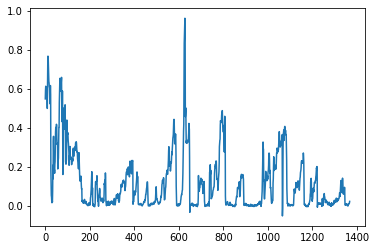

In [129]:
plt.plot(yhat)

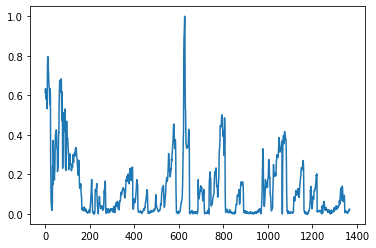

In [130]:
plt.plot(y_split_test)

In [131]:
_, train_acc = model.evaluate(X_split_train, y_split_train, verbose=0)
_, test_acc = model.evaluate(X_split_test, y_split_test, verbose=0)
print('Train: %.5f, Test: %.5f' % (train_acc, test_acc))

Train: 0.01320, Test: 0.01681


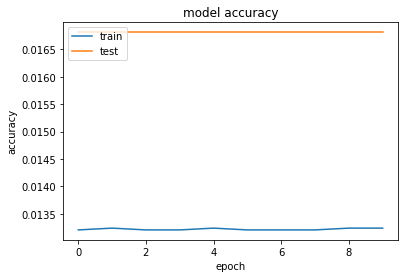

In [132]:
# summarize history for accuracy
plt.plot(hist.history['accuracy'])
plt.plot(hist.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

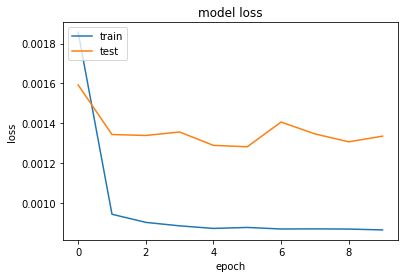

In [133]:
# summarize history for loss
plt.plot(hist.history['loss'])
plt.plot(hist.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

Train on 30522 samples, validate on 1368 samples
Epoch 1/10
30522/30522 [==============================] - 5s 155us/step - loss: 8.6641e-04 - accuracy: 0.0132 - val_loss: 0.0013 - val_accuracy: 0.0168
Epoch 2/10
30522/30522 [==============================] - 5s 155us/step - loss: 8.6385e-04 - accuracy: 0.0132 - val_loss: 0.0012 - val_accuracy: 0.0168
Epoch 3/10
30522/30522 [==============================] - 5s 155us/step - loss: 8.6117e-04 - accuracy: 0.0132 - val_loss: 0.0012 - val_accuracy: 0.0168
Epoch 4/10
30522/30522 [==============================] - 5s 156us/step - loss: 8.5554e-04 - accuracy: 0.0132 - val_loss: 0.0013 - val_accuracy: 0.0168
Epoch 5/10
30522/30522 [==============================] - 5s 156us/step - loss: 8.4824e-04 - accuracy: 0.0132 - val_loss: 0.0013 - val_accuracy: 0.0168
Epoch 6/10
30522/30522 [==============================] - 5s 157us/step - loss: 8.5324e-04 - accuracy: 0.0132 - val_loss: 0.0013 - val_accuracy: 0.0168
Epoch 7/10
30522/30522 [===============

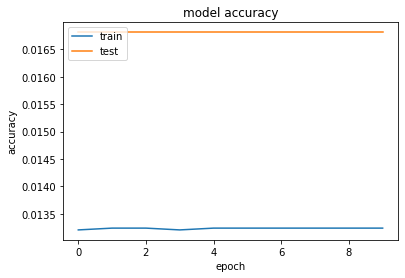

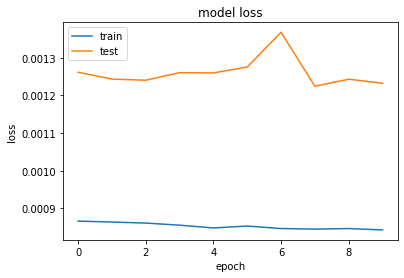

Train on 30522 samples, validate on 1368 samples
Epoch 1/10
30522/30522 [==============================] - 5s 155us/step - loss: 0.0013 - accuracy: 9.8290e-05 - val_loss: 0.0014 - val_accuracy: 0.0022
Epoch 2/10
30522/30522 [==============================] - 5s 157us/step - loss: 0.0013 - accuracy: 9.8290e-05 - val_loss: 0.0012 - val_accuracy: 0.0022
Epoch 3/10
30522/30522 [==============================] - 5s 160us/step - loss: 0.0013 - accuracy: 9.8290e-05 - val_loss: 0.0013 - val_accuracy: 0.0022
Epoch 4/10
30522/30522 [==============================] - 5s 157us/step - loss: 0.0013 - accuracy: 9.8290e-05 - val_loss: 0.0013 - val_accuracy: 0.0022
Epoch 5/10
30522/30522 [==============================] - 5s 158us/step - loss: 0.0013 - accuracy: 9.8290e-05 - val_loss: 0.0012 - val_accuracy: 0.0022
Epoch 6/10
30522/30522 [==============================] - 5s 152us/step - loss: 0.0013 - accuracy: 9.8290e-05 - val_loss: 0.0013 - val_accuracy: 0.0022
Epoch 7/10
30522/30522 [===============

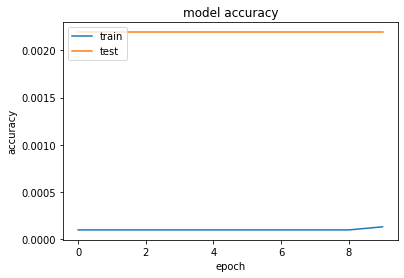

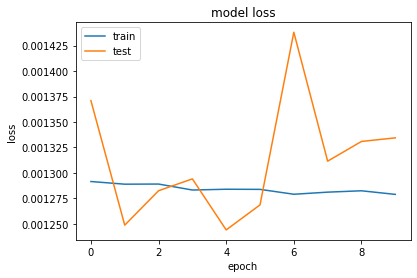

Train on 30522 samples, validate on 1368 samples
Epoch 1/10
30522/30522 [==============================] - 5s 156us/step - loss: 7.2720e-04 - accuracy: 9.8290e-05 - val_loss: 0.0018 - val_accuracy: 0.0409
Epoch 2/10
30522/30522 [==============================] - 5s 159us/step - loss: 7.1915e-04 - accuracy: 9.8290e-05 - val_loss: 0.0018 - val_accuracy: 0.0409
Epoch 3/10
30522/30522 [==============================] - 5s 159us/step - loss: 7.1524e-04 - accuracy: 9.8290e-05 - val_loss: 0.0017 - val_accuracy: 0.0409
Epoch 4/10
30522/30522 [==============================] - 5s 159us/step - loss: 7.1670e-04 - accuracy: 9.8290e-05 - val_loss: 0.0017 - val_accuracy: 0.0409
Epoch 5/10
30522/30522 [==============================] - 5s 159us/step - loss: 7.1380e-04 - accuracy: 9.8290e-05 - val_loss: 0.0017 - val_accuracy: 0.0409
Epoch 6/10
30522/30522 [==============================] - 5s 159us/step - loss: 7.1460e-04 - accuracy: 9.8290e-05 - val_loss: 0.0018 - val_accuracy: 0.0409
Epoch 7/10
3052

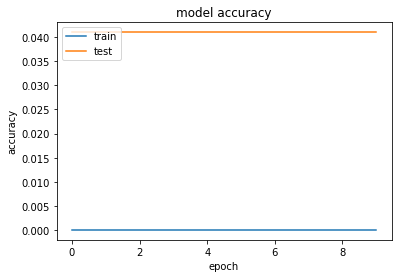

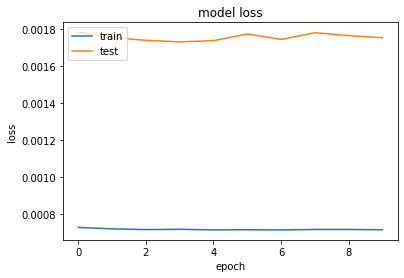

Train on 30522 samples, validate on 1368 samples
Epoch 1/10
30522/30522 [==============================] - 5s 155us/step - loss: 0.0018 - accuracy: 0.0023 - val_loss: 0.0051 - val_accuracy: 0.0029
Epoch 2/10
30522/30522 [==============================] - 5s 160us/step - loss: 0.0018 - accuracy: 0.0023 - val_loss: 0.0049 - val_accuracy: 0.0029
Epoch 3/10
30522/30522 [==============================] - 5s 156us/step - loss: 0.0018 - accuracy: 0.0023 - val_loss: 0.0051 - val_accuracy: 0.0029
Epoch 4/10
30522/30522 [==============================] - 5s 155us/step - loss: 0.0018 - accuracy: 0.0023 - val_loss: 0.0050 - val_accuracy: 0.0029
Epoch 5/10
30522/30522 [==============================] - 5s 154us/step - loss: 0.0018 - accuracy: 0.0023 - val_loss: 0.0049 - val_accuracy: 0.0029
Epoch 6/10
30522/30522 [==============================] - 5s 158us/step - loss: 0.0018 - accuracy: 0.0023 - val_loss: 0.0049 - val_accuracy: 0.0029
Epoch 7/10
30522/30522 [==============================] - 5s 15

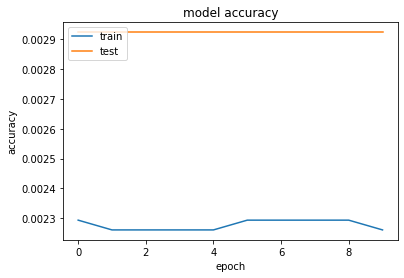

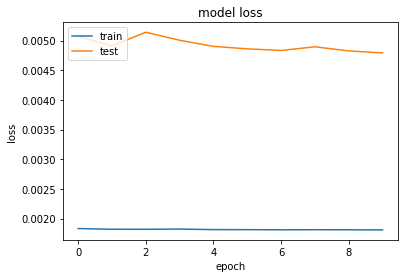

Train on 30522 samples, validate on 1368 samples
Epoch 1/10
30522/30522 [==============================] - 5s 155us/step - loss: 0.0012 - accuracy: 0.0056 - val_loss: 0.0063 - val_accuracy: 0.0285
Epoch 2/10
30522/30522 [==============================] - 5s 156us/step - loss: 0.0012 - accuracy: 0.0056 - val_loss: 0.0066 - val_accuracy: 0.0285
Epoch 3/10
30522/30522 [==============================] - 4s 146us/step - loss: 0.0012 - accuracy: 0.0056 - val_loss: 0.0064 - val_accuracy: 0.0285
Epoch 4/10
30522/30522 [==============================] - 5s 159us/step - loss: 0.0012 - accuracy: 0.0056 - val_loss: 0.0064 - val_accuracy: 0.0285
Epoch 5/10
30522/30522 [==============================] - 5s 157us/step - loss: 0.0012 - accuracy: 0.0056 - val_loss: 0.0064 - val_accuracy: 0.0285
Epoch 6/10
30522/30522 [==============================] - 5s 156us/step - loss: 0.0012 - accuracy: 0.0056 - val_loss: 0.0064 - val_accuracy: 0.0285
Epoch 7/10
30522/30522 [==============================] - 5s 16

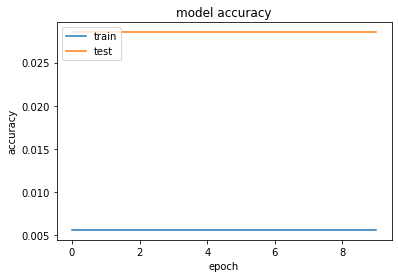

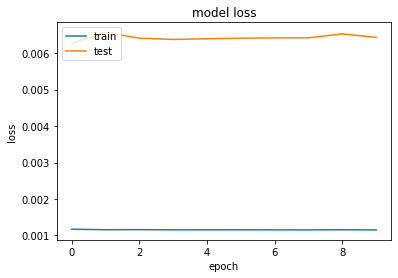

Train on 30522 samples, validate on 1368 samples
Epoch 1/10
30522/30522 [==============================] - 5s 155us/step - loss: 0.0013 - accuracy: 2.2934e-04 - val_loss: 0.0135 - val_accuracy: 0.0943
Epoch 2/10
30522/30522 [==============================] - 5s 152us/step - loss: 0.0012 - accuracy: 2.2934e-04 - val_loss: 0.0134 - val_accuracy: 0.0943
Epoch 3/10
30522/30522 [==============================] - 5s 158us/step - loss: 0.0012 - accuracy: 2.2934e-04 - val_loss: 0.0131 - val_accuracy: 0.0943
Epoch 4/10
30522/30522 [==============================] - 5s 160us/step - loss: 0.0012 - accuracy: 2.2934e-04 - val_loss: 0.0131 - val_accuracy: 0.0943
Epoch 5/10
30522/30522 [==============================] - 5s 156us/step - loss: 0.0012 - accuracy: 2.2934e-04 - val_loss: 0.0138 - val_accuracy: 0.0928
Epoch 6/10
30522/30522 [==============================] - 5s 159us/step - loss: 0.0012 - accuracy: 2.2934e-04 - val_loss: 0.0135 - val_accuracy: 0.0943
Epoch 7/10
30522/30522 [===============

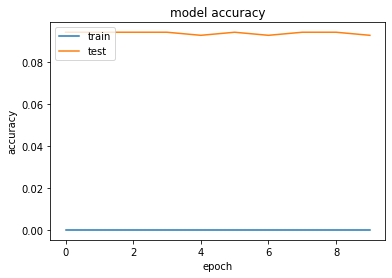

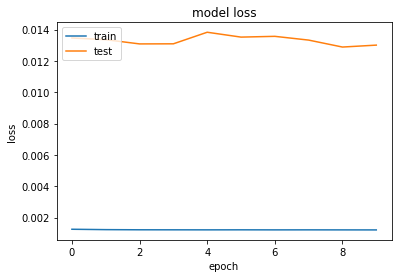

In [134]:
def compute(var):
    train_norm = x_train[var] 
    train_norm_arr = np.asarray(train_norm)
    train_norm = np.reshape(train_norm_arr, (-1, 1))
    scaler = MinMaxScaler(feature_range=(0, 1))
    train_norm = scaler.fit_transform(train_norm)

    test_norm = x_test[var]
    test_norm_arr = np.asarray(test_norm)
    test_norm = np.reshape(test_norm_arr, (-1, 1))
    scaler = MinMaxScaler(feature_range=(0, 1))
    test_norm = scaler.fit_transform(test_norm)

    X_split_train, y_split_train = split_sequence(train_norm, n_steps)
    X_split_train = X_split_train.reshape((X_split_train.shape[0], X_split_train.shape[1], n_features))

    X_split_test, y_split_test = split_sequence(test_norm, n_steps)
    X_split_test = X_split_test.reshape((X_split_test.shape[0], X_split_test.shape[1], n_features))

    hist = model.fit(X_split_train, y_split_train, validation_data=(X_split_test, y_split_test), epochs=10, verbose = 1)

    yhat = model.predict(X_split_test)

    mse = mean_squared_error(y_split_test, yhat)
    print(mse)
    
    plt.plot(hist.history['accuracy'])
    plt.plot(hist.history['val_accuracy'])
    plt.title('model accuracy')
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train', 'test'], loc='upper left')
    plt.show()

    plt.plot(hist.history['loss'])
    plt.plot(hist.history['val_loss'])
    plt.title('model loss')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'test'], loc='upper left')
    plt.show()
    
compute('PM2.5')
compute('PM10')
compute('SO2')
compute('NO2')
compute('CO')
compute('O3')

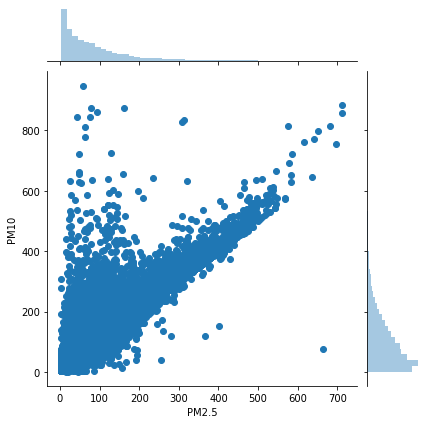

In [135]:
sns.jointplot(x=df['PM2.5'], y=df['PM10'], data = df)

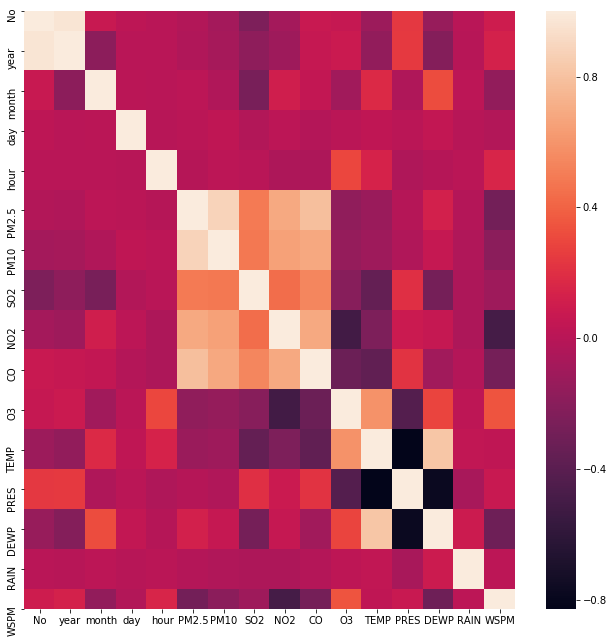

In [136]:
corrmat = df.corr()
fig, ax = plt.subplots(figsize=(11,11))
sns.heatmap(corrmat)

C:\ProgramData\Anaconda3\lib\site-packages\numpy\lib\histograms.py:824: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
C:\ProgramData\Anaconda3\lib\site-packages\numpy\lib\histograms.py:825: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


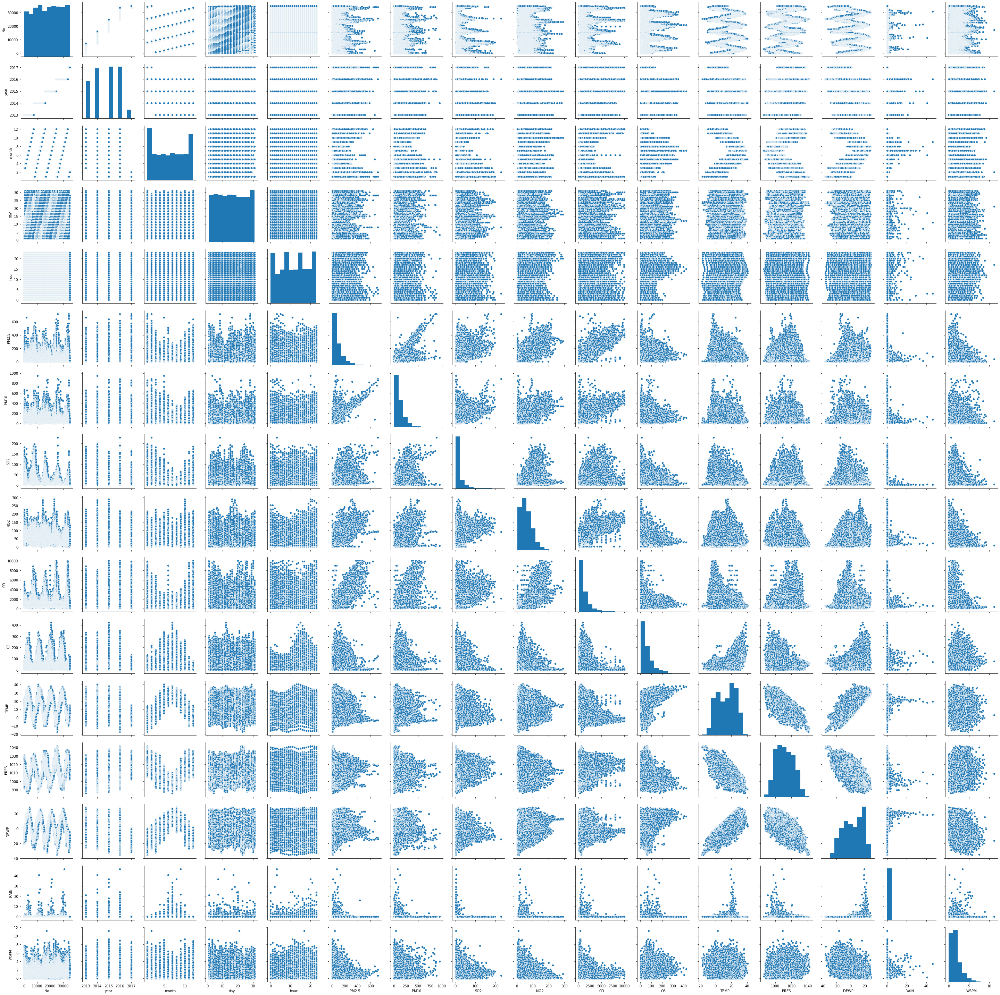

In [137]:
g = sns.pairplot(df)

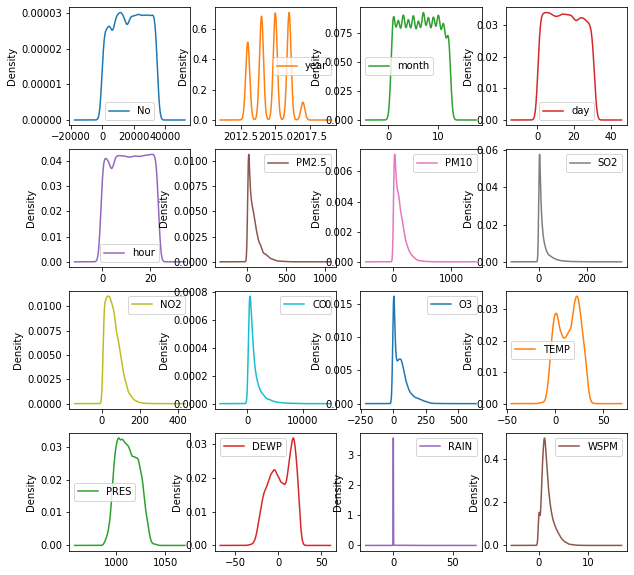

In [138]:
df.plot(kind='density', subplots=True, layout=(4,4), sharex=False, figsize=(10,10))
plt.show()

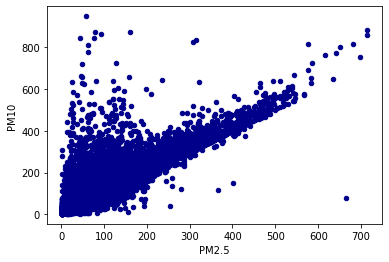

In [139]:
df.plot.scatter(x='PM2.5', y='PM10', c='DarkBlue')

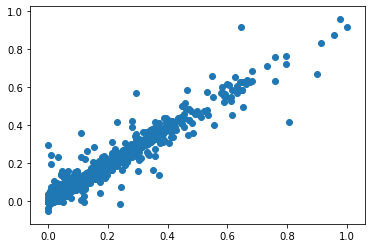

In [140]:
plt.scatter(y_split_test, yhat)

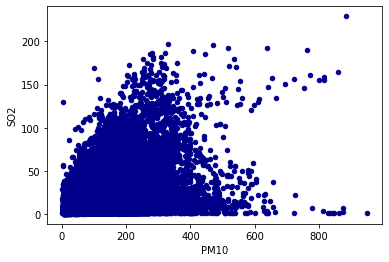

In [141]:
df.plot.scatter(x='PM10', y='SO2', c='DarkBlue')

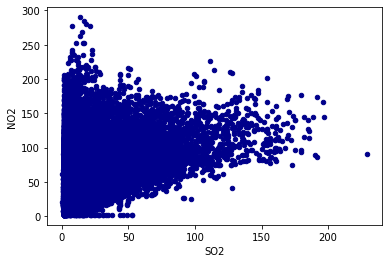

In [142]:
df.plot.scatter(x='SO2', y='NO2', c='DarkBlue')

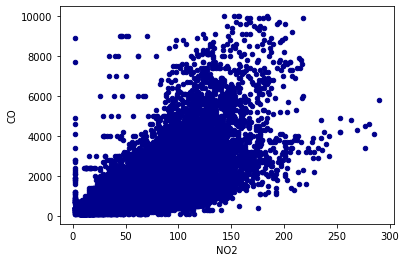

In [143]:
df.plot.scatter(x='NO2', y='CO', c='DarkBlue')

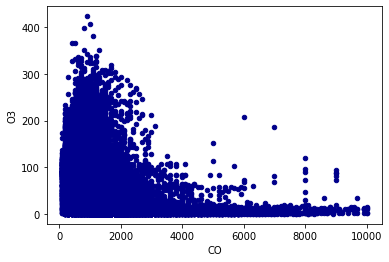

In [144]:
df.plot.scatter(x='CO', y='O3', c='DarkBlue')

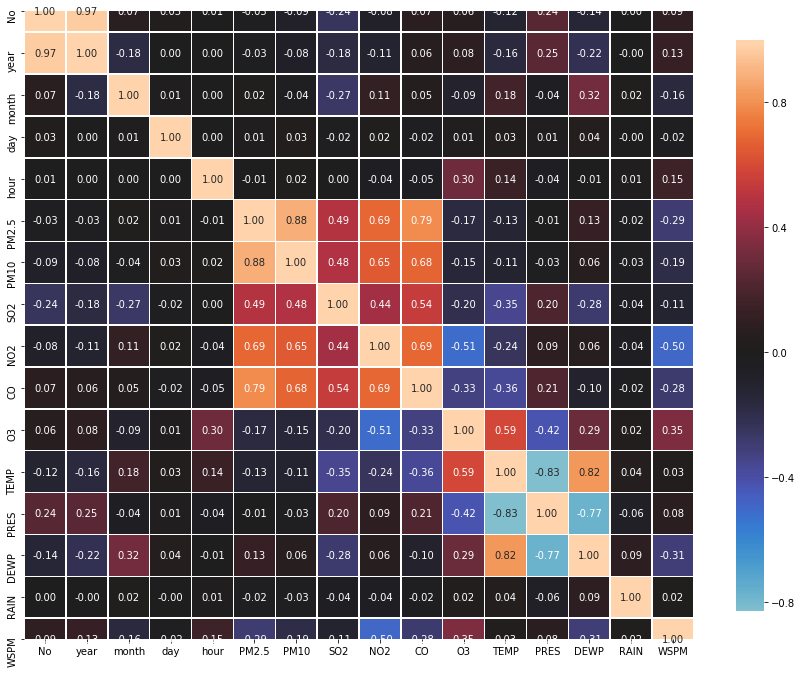

In [145]:
correlations = df.corr()
fig, ax = plt.subplots(figsize=(15,15))
sns.heatmap(correlations, vmax=1.0, center=0, fmt='.2f', square=True, linewidths=.5, annot=True, cbar_kws={"shrink": .70})
plt.show();